In [2]:
!unzip CDNOW_master.zip

Archive:  CDNOW_master.zip
replace CDNOW_master.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: ^C


In [3]:
!head CDNOW_master.txt

In [4]:
!cat read_me_CDNOW_master.txt

In [5]:
#Sacamos los datos y los ponemos en formato de DF
import pandas as pd

In [6]:
df=pd.read_csv("CDNOW_master.txt",header=None)

In [7]:
df.head()

,0
0,00001 19970101 1 11.77
1,00002 19970112 1 12.00
2,00002 19970112 5 77.00
3,00003 19970102 2 20.76
4,00003 19970330 2 20.76


In [8]:
#leemos con python y creamos una interfaz
f=open("CDNOW_master.txt")

In [9]:
#para leer el fichero
contenido=f.read()

In [10]:
#para ver los primeros 10 caracteres que el fichero (es un como las listas en python)
contenido[:100]

' 00001 19970101  1   11.77\n 00002 19970112  1   12.00\n 00002 19970112  5   77.00\n 00003 19970102  2 '

In [11]:
lista_lineas=contenido.split("\n")

In [12]:
lista_lineas[:5]

[' 00001 19970101  1   11.77',
 ' 00002 19970112  1   12.00',
 ' 00002 19970112  5   77.00',
 ' 00003 19970102  2   20.76',
 ' 00003 19970330  2   20.76']

In [13]:
#ahora transformamos para poner esto como una table
#para pasear .split() sin nada, así me separará las columnas (para aplicar todas las filas lo podemos hacer con un map)
primera_linea=lista_lineas[0]
primera_linea.split()

['00001', '19970101', '1', '11.77']

In [14]:
map(lambda e: e.split(),lista_lineas)

In [15]:
#map es un generador (objeto generador) un objeto generador que no hará nada con él hasta que no lo calcule o haga algo sobre el.
#Si yo el map no lo uso en ningun sitio no voy a poder accerder a el. para ello lo pasamos a una lista

In [16]:
elementos=list(map(lambda e: e.split(),lista_lineas))
type(elementos)

list

In [17]:
elementos[:5]

[['00001', '19970101', '1', '11.77'],
 ['00002', '19970112', '1', '12.00'],
 ['00002', '19970112', '5', '77.00'],
 ['00003', '19970102', '2', '20.76'],
 ['00003', '19970330', '2', '20.76']]

In [18]:
#tengo una lista de listas y ahora solo me queda convertirlo en un DF
df=pd.DataFrame(elementos)

In [19]:
df.head()

,0,1,2,3
0,00001,19970101,1,11.77
1,00002,19970112,1,12.00
2,00002,19970112,5,77.00
3,00003,19970102,2,20.76
4,00003,19970330,2,20.76


In [20]:
#Borramos los none
df=df.dropna()
#Y así podemos resolver como leer un txt.
#ahora para poner nombre a las columnas
df.columns=["customerID","date",'quantity','money']

In [21]:
df.head()

,customerID,date,quantity,money
0,00001,19970101,1,11.77
1,00002,19970112,1,12.00
2,00002,19970112,5,77.00
3,00003,19970102,2,20.76
4,00003,19970330,2,20.76


In [22]:
#tenemos un problema con los datos, hay que definilos de forma correspondiente. Son todas las columnas objetos de cadenas de caracteres.
df.dtypes

customerID    object
date          object
quantity      object
money         object
dtype: object

In [23]:
#las dataset se dividen en dimensiones y medidas. las dimensiones como customerID pueden ser de un tipo u otro, no se va a hacer una suma con esto ni otra operacion
pd.to_datetime(df['date'],format='%Y%m%d')
#para ver el formato tenemos que poner una cadena de caracteres que represente la fecha tal y como está en la columna
#para ello buscamos en google: datetime python formart

0       1997-01-01
1       1997-01-12
2       1997-01-12
3       1997-01-02
4       1997-03-30
5       1997-04-02
6       1997-11-15
7       1997-11-25
8       1998-05-28
9       1997-01-01
10      1997-01-18
11      1997-08-02
12      1997-12-12
13      1997-01-01
14      1997-01-14
15      1997-02-04
16      1997-04-11
17      1997-05-31
18      1997-06-16
19      1997-07-22
20      1997-09-15
21      1997-12-08
22      1997-12-12
23      1998-01-03
24      1997-01-01
25      1997-01-01
26      1997-10-11
27      1998-03-22
28      1997-01-01
29      1997-02-13
           ...    
69629   1997-09-27
69630   1998-01-03
69631   1998-06-07
69632   1997-03-25
69633   1997-03-25
69634   1997-05-18
69635   1997-06-24
69636   1998-02-25
69637   1997-03-25
69638   1997-05-18
69639   1997-06-27
69640   1997-03-25
69641   1997-03-25
69642   1998-01-28
69643   1998-05-29
69644   1997-03-25
69645   1997-03-25
69646   1997-10-04
69647   1997-03-25
69648   1997-05-21
69649   1997-11-30
69650   1997

In [24]:
#Esto nos devuelve otra serie que tenemos que guardar en el mismos sitio donde la hemos extraido

In [25]:
df['date']=pd.to_datetime(df['date'],format='%Y%m%d')

In [26]:
df.dtypes

customerID            object
date          datetime64[ns]
quantity              object
money                 object
dtype: object

In [27]:
#parseamos la cantidad a entereros: elegimos la columna que queremos y usamos .astype(tipo)
#pasamos a float porque a int da error, posiblemente por los no nulos.
df['quantity']=df['quantity'].astype(float)
df.dtypes

customerID            object
date          datetime64[ns]
quantity             float64
money                 object
dtype: object

In [28]:
#hacemos lo mismo con la columna money
df['money']=df['money'].astype(float)
df.dtypes

customerID            object
date          datetime64[ns]
quantity             float64
money                float64
dtype: object

In [29]:
#vemos si tenemos columnas nulas. Selecciono los que sean nulos y veo el nº de valores vacios. cuando haya mas podemos hacer un len() para saber el numero
df[df.isnull()['quantity']]
#tenemos que seleccionar las lineas con una serie de true or false y no con un DF, por ello le pasamos ['quantity']

,customerID,date,quantity,money


In [30]:
#para quitarlos, con drop

In [31]:
df.head()

,customerID,date,quantity,money
0,00001,1997-01-01,1.0,11.77
1,00002,1997-01-12,1.0,12.00
2,00002,1997-01-12,5.0,77.00
3,00003,1997-01-02,2.0,20.76
4,00003,1997-03-30,2.0,20.76


In [32]:
#intentamos crear un DF agrupando por día cuanto dinero se recauda. Usamos un groupby y posteriormente hacemos la suma 
#df.groupby(['date'])['money'].sum()
#si lo hacemos con el df completo, no solo con la col money lo hará con todas las columnas numéricas
per_date=df.groupby('date').sum()

In [33]:
#Co esto cargamos numpy, matplolib y lo pone para que salga en el notebook
%pylab inline

Populating the interactive namespace from numpy and matplotlib


/home/dsc/anaconda3/lib/python3.6/site-packages/IPython/core/magics/pylab.py:160: UserWarning: pylab import has clobbered these variables: ['f']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


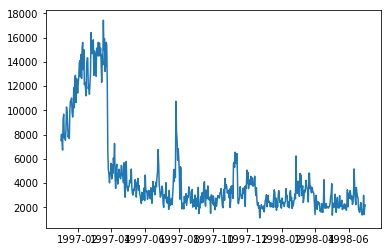

In [34]:
#ploteamos
plt.plot(per_date.index,per_date['money'])

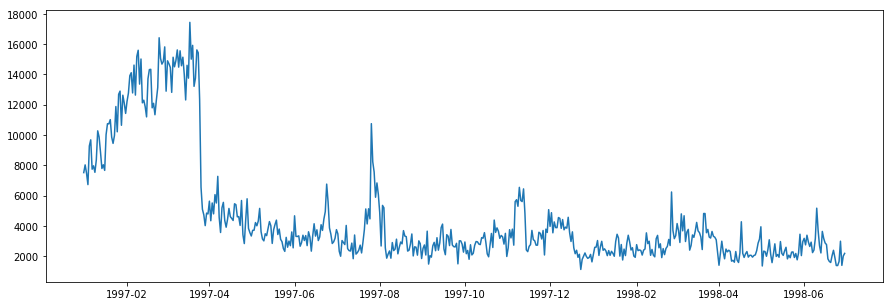

In [35]:
#para estirar el gráfico y poder ver el eje de fechas
plt.figure(figsize=(15,5))
plt.plot(per_date.index,per_date['money']);
#con ; al final no sale el texto indicador del objeto y su dirección.

In [36]:
#vemos ahora la actividad de un cliente individualmente
df[df['customerID']=='00007']
#y estas serían todas las transacciones que ha hecho el cliente 0007

,customerID,date,quantity,money
25,00007,1997-01-01,2.0,28.74
26,00007,1997-10-11,7.0,97.43
27,00007,1998-03-22,9.0,138.50


In [37]:
#ahora, vamos a coger todos los id sin que se repitan 
all_cid=df['customerID'].unique()
all_cid

array(['00001', '00002', '00003', ..., '23568', '23569', '23570'],
      dtype=object)

In [38]:
#haciendo una seleccion del customer id con un menú interactivo.
from ipywidgets import interact
@interact(cid=all_cid[:100])
def show_cid(cid):
    return df[df['customerID']==cid]

interactive(children=(Dropdown(description='cid', options=('00001', '00002', '00003', '00004', '00005', '00006', '00007', '00008', '00009', '00010', '00011', '00012', '00013', '00014', '00015', '00016', '00017', '00018', '00019', '00020', '00021', '00022', '00023', '00024', '00025', '00026', '00027', '00028', '00029', '00030', '00031', '00032', '00033', '00034', '00035', '00036', '00037', '00038', '00039', '00040', '00041', '00042', '00043', '00044', '00045', '00046', '00047', '00048', '00049', '00050', '00051', '00052', '00053', '00054', '00055', '00056', '00057', '00058', '00059', '00060', '00061', '00062', '00063', '00064', '00065', '00066', '00067', '00068', '00069', '00070', '00071', '00072', '00073', '00074', '00075', '00076', '00077', '00078', '00079', '00080', '00081', '00082', '00083', '00084', '00085', '00086', '00087', '00088', '00089', '00090', '00091', '00092', '00093', '00094', '00095', '00096', '00097', '00098', '00099', '00100'), value='00001'), Output()), _dom_classes=('widget-interact',))

In [39]:
df.dtypes

customerID            object
date          datetime64[ns]
quantity             float64
money                float64
dtype: object

TypeError: ufunc subtract cannot use operands with types dtype('<M8[ns]') and dtype('float64')

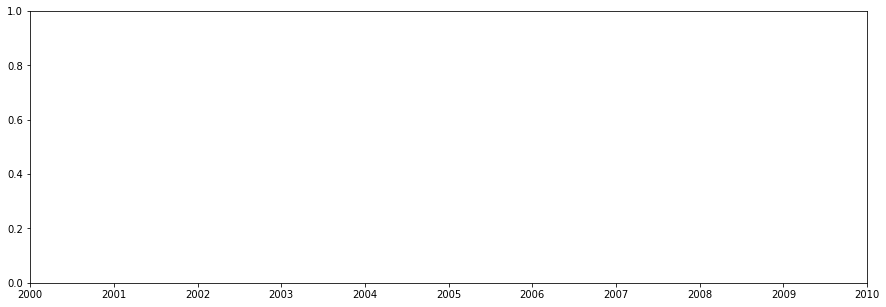

In [40]:
#hacemos lo mismo con un gráfico y con el cliente 89 (gráfico interactivo)
cliente89=df[df['customerID']=='00089']
plt.figure(figsize=(15,5))
plt.bar(cliente89['date'],cliente89['money'])


In [41]:
#plotly permite hacer gráficos en 3d. Vamos a usarlo a ver si por esto por lo que da fallo en la representacion

In [42]:
import plotly.offline as py
import plotly.graph_objs as go

In [43]:
#iniciamos el notebook mode diciendole que estamos conectados a internet
py.init_notebook_mode(connected=True)

In [44]:
#probamos el plotly
py.iplot([go.Bar(x=cliente89['date'],y=cliente89['quantity'])])

In [45]:
@interact(cid=all_cid[:100])
def show_cid(cid):
    temp=df[df['customerID']==cid]
    py.iplot([go.Bar(x=temp['date'],y=temp['quantity'])])

interactive(children=(Dropdown(description='cid', options=('00001', '00002', '00003', '00004', '00005', '00006', '00007', '00008', '00009', '00010', '00011', '00012', '00013', '00014', '00015', '00016', '00017', '00018', '00019', '00020', '00021', '00022', '00023', '00024', '00025', '00026', '00027', '00028', '00029', '00030', '00031', '00032', '00033', '00034', '00035', '00036', '00037', '00038', '00039', '00040', '00041', '00042', '00043', '00044', '00045', '00046', '00047', '00048', '00049', '00050', '00051', '00052', '00053', '00054', '00055', '00056', '00057', '00058', '00059', '00060', '00061', '00062', '00063', '00064', '00065', '00066', '00067', '00068', '00069', '00070', '00071', '00072', '00073', '00074', '00075', '00076', '00077', '00078', '00079', '00080', '00081', '00082', '00083', '00084', '00085', '00086', '00087', '00088', '00089', '00090', '00091', '00092', '00093', '00094', '00095', '00096', '00097', '00098', '00099', '00100'), value='00001'), Output()), _dom_classes=('widget-interact',))

In [46]:
df.to_csv('transacciones.csv',index=False)
#esto es para exportar el dataframe y visualizarlo en herramientas como Tableau

In [47]:
cliente89_calibrado=cliente89[cliente89['date']<'1997-09-30']
cliente89_calibrado

,customerID,date,quantity,money
337,00089,1997-01-01,3.0,47.08
338,00089,1997-01-11,2.0,30.72
339,00089,1997-01-29,2.0,30.72
340,00089,1997-03-27,2.0,27.13
341,00089,1997-04-11,1.0,20.97
342,00089,1997-05-27,1.0,15.36
343,00089,1997-07-30,4.0,60.67
344,00089,1997-08-23,2.0,46.42


In [48]:
#Vamos a calcular el recency, frecuency y monetary qye es la refpresentacion por excelencia qye se hace en la sergmentacion de clientes


In [49]:
#Recency
from datetime import datetime

In [50]:
(datetime(1997,9,30)-cliente89_calibrado['date'].max()).days

38

In [51]:
#esto significa que el cliente 89 hace 38 días compró
#cuanto se gastó?

In [52]:
#Monetary.Lo que se gasta en ese periodo
cliente89_calibrado['money'].sum()

279.07

In [53]:
#Frecuency.
len(cliente89_calibrado)

8

In [54]:
#ahora hay que hacerlo para todos los clientes. Esto lo podemos hacer con el groupby de clientes
#usamos la funcion apply para usar nuestras propias funciones de agregacion tales como sum(), mean()...

In [61]:
def process(df):
    recency=(datetime(1997,9,30)-df['date'].max()).days
    frequency=len(df)
    monetary=df['money'].sum()
    #si devuelvo una serie en vez de una lista, si hacemos el apply despues tendremos un dataframe
    return pd.Series([recency,frequency,monetary])

#antes de aplicar la fución tenemos que cablibrar
df_calibrado=df[df['date']<'1997-09-30'].copy()
rfm=df_calibrado.groupby('customerID').apply(process)

In [62]:
#Ahora rfm es un df, si no hubieramos devuelto en la funcion una serie, rfm seria una serie.
rfm[rfm.index=='00089']

,0,1,2
customerID,,,
00089,38.0,8.0,279.07


In [63]:
#vamos a resetear el index. Ahora customer ID será otra vez las columnas. A su vez le vamos a dar el nombre a las columnas
rfm.columns=['recency','frequency','monetary']
rfm=rfm.reset_index()

In [64]:
rfm.head()

,customerID,recency,frequency,monetary
0,00001,272.0,1.0,11.77
1,00002,261.0,2.0,89.00
2,00003,181.0,3.0,61.06
3,00004,59.0,3.0,74.02
4,00005,15.0,8.0,261.21


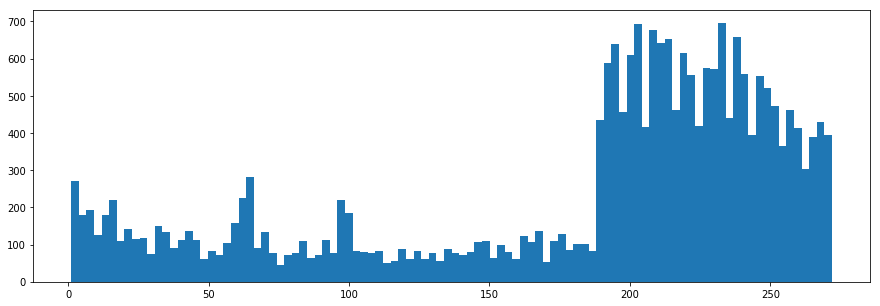

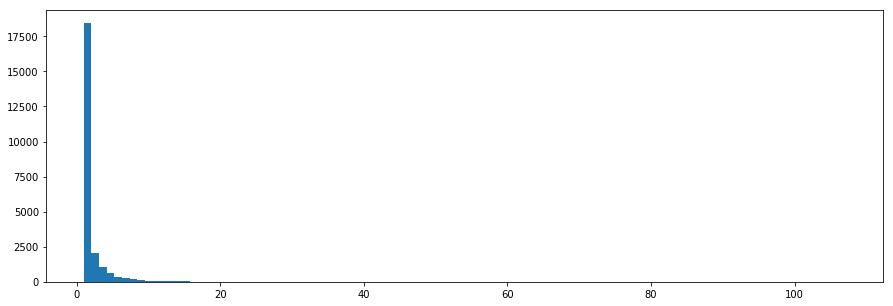

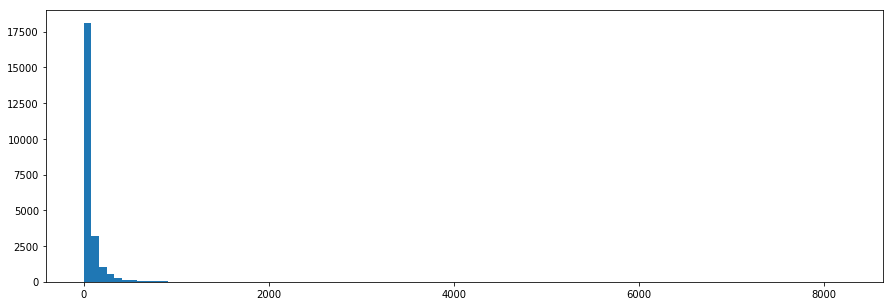

In [65]:
#Una vez tenemos ya los datos así vamos a explorar un poco los datos usando un histograma
for col in ['recency','frequency','monetary']:
    plt.figure(figsize=(15,5))
    plt.hist(rfm[col],bins=100)
    plt.show()

In [ ]:
#Son distribuciones exponenciales.

2 formas de afrontar estos problemas de modelado.
-modelado estadistico: se basa en distribuciones de probabilidad (ej: banca, seguros...)
-modelado machine learneing: encuentran modelo segun los datos. Hacen falta muchos datos. AL final el modelo converge al resultado

In [66]:
#vemos en 3d los datos
py.iplot([go.Scatter3d(x=rfm['recency'],y=rfm['frequency'],z=rfm['monetary'],mode='markers')])

In [67]:
#la segmentacion de clientes basadas en distancias cuando los datos estan muyy juntos es un problema.

In [69]:
#para empezar podemos hacer una segmentacion por cuantiles (SEGMENTACÓN ESTADÍSTICA)
#para ello puedo usar el histograma y añadir una linea horizontal en los percentiles
import numpy as np
np.percentile(rfm['recency'],50)


208.0

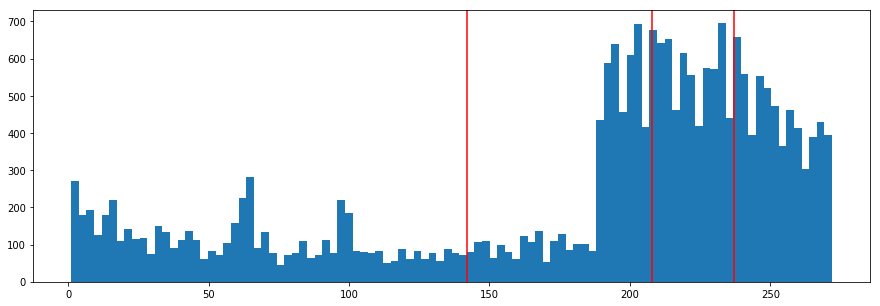

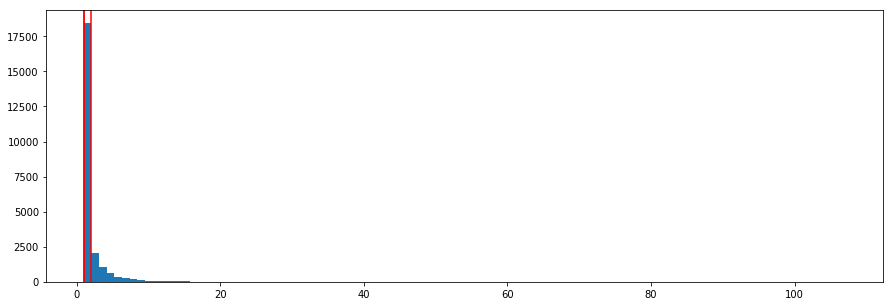

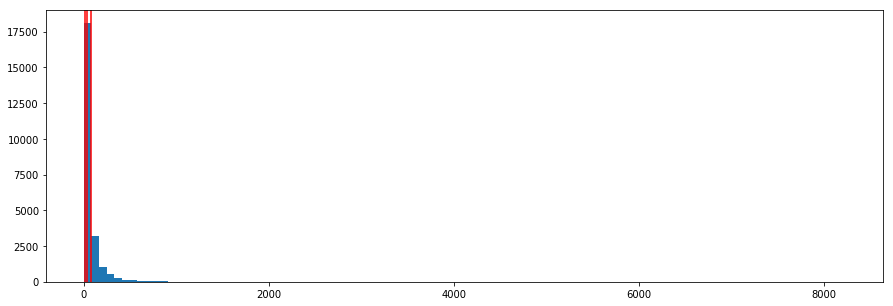

In [70]:

for col in ['recency','frequency','monetary']:
    plt.figure(figsize=(15,5))
    plt.hist(rfm[col],bins=100)
    for p in [25,50,75]:
        plt.axvline(np.percentile(rfm[col],p),color='red')
    plt.show()

In [ ]:
#como vemos para recency se verá muy bien pero para las otras dos super juntas.
#la segmentacion por cuantiles es una segmentacion estadística.

In [ ]:
#Vemos que no funcionaría. Vamos a usar una segmentación tipo ML.
#VAMOS A USAR EL MÉTODO K-MEANS

In [71]:
from sklearn.cluster import KMeans

In [73]:
#extraigo las caracteristicas que quiero y les digo las columnas que me interesan
X=rfm[['recency','frequency','monetary']].values
#esto es un array (lista de listas)
X

array([[272.  ,   1.  ,  11.77],
       [261.  ,   2.  ,  89.  ],
       [181.  ,   3.  ,  61.06],
       ...,
       [161.  ,   3.  , 121.7 ],
       [189.  ,   1.  ,  25.74],
       [188.  ,   2.  ,  94.08]])

In [74]:
#Creamos una instancia del modelo, tenemos que indicar el número de clusters
model=KMeans(n_clusters=5)

In [76]:
#etiquetas
labels=model.fit_predict(X)
labels

array([0, 0, 0, ..., 4, 0, 0], dtype=int32)

In [77]:
len(X)

23570

In [78]:
len(labels)

23570

In [79]:
#vamos el modelo 3d, el clustering que ha hecho el kmeans
py.iplot([go.Scatter3d(x=rfm['recency'],
                       y=rfm['frequency'],
                       z=rfm['monetary'],
                       mode='markers',
                       marker={'color':labels})])

In [ ]:
#problemas del kmeans: Mucha densidad de puntos en la misma region-->dificultad en la conversion
#Hay que tener cuidado con los datos de entrada en el kmeans.

In [ ]:
#vamos a PREPROCESAR(escalar,normalizar) los datos y vamos a volver a correrlo a ver que pasa.

In [80]:
#Ver tipo de escaladores en la web (Sklearn)
#nosotros vamos a usar un escalador robusto (usa la mediana, por eso es lo de robusto)


In [81]:
from sklearn.preprocessing import RobustScaler

In [82]:
rbs=RobustScaler()
X_escalado=rbs.fit_transform(X)

In [83]:
py.iplot([go.Scatter3d(x=X_escalado[:,0],
                       y=X_escalado[:,1],
                       z=X_escalado[:,2],
                       mode='markers',
                       marker={'color':labels})])

In [84]:
#Si ahora predigo las etiquetas con los X_escalado
#etiquetas
labels=model.fit_predict(X_escalado)
labels

array([2, 2, 0, ..., 0, 2, 2], dtype=int32)

In [85]:
py.iplot([go.Scatter3d(x=X_escalado[:,0],
                       y=X_escalado[:,1],
                       z=X_escalado[:,2],
                       mode='markers',
                       marker={'color':labels})])

In [86]:
#El problema puede ser que la distribucion sea exponencial.
#Para ello usamos la normalizacion(transformacion) de BoxCox la cual transforma la distribucion de los datos
from scipy import stats
rfm_o=rfm.copy()

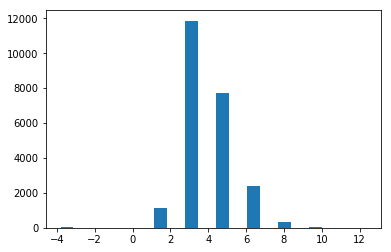

In [87]:
#como tengo algunos monetary=0 voy a ponerlos igual a 0.01
plt.hist(stats.boxcox(rfm['monetary']+0.01));
#me estira la districucion

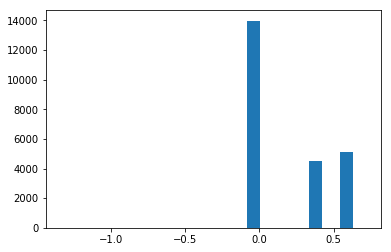

In [88]:
#lo hago para frequency tambien
plt.hist(stats.boxcox(rfm['frequency']+0.01));

In [90]:
#guardo esta nueva transformacion tanto para monetary como para frequency
rfm['frequency']=stats.boxcox(rfm['frequency']+0.01)[0]
rfm['monetary']=stats.boxcox(rfm['monetary']+0.01)[0]

In [94]:
X_t=rfm[['recency','frequency','monetary']].values
#Si ahora predigo las etiquetas con los X_t
labels_t=model.fit_predict(X_t)
labels_t

array([2, 2, 0, ..., 3, 0, 0], dtype=int32)

In [95]:
py.iplot([go.Scatter3d(x=X_t[:,0],
                       y=X_t[:,1],
                       z=X_t[:,2],
                       mode='markers',
                       marker={'color':labels_t})])

In [96]:
#vemos como ahora se distinguen mucho mejor los clusters pero a su vez, gracias al color de las labels sabemos que está mal.
#como se basa en distancias no es realmente lo que nosotros queremos.

In [97]:
#VER NOTEBOOK DEL PROFESRO DEONDE SE APLICA EL MODELO PARA UN Nº DISTINTO DE CLUSTERS Y DEMÁS PRUEBAS. COPIARLO AQUI DESPUES

In [99]:
#otras opciones de sgmentacion usando otros métodos distintos como por ejemplo DBSCAN (se basa en la distancia y es capaz de reconocerte outlayer)

In [100]:
from sklearn.cluster import DBSCAN

In [102]:
#modificando el epsilon podemos cambiar el comportamiento (con 0.2 mejor que cuando vale 0.1)
model2=DBSCAN(eps=0.2)
labels2=model2.fit_predict(X_escalado)
py.iplot([go.Scatter3d(x=rfm['recency'],
                       y=rfm['frequency'],
                       z=rfm['monetary'],
                       mode='markers',
                       marker={'color':labels2})])

In [ ]:
#se recomienda hacer clustering con como maximo 20 variables. hay tecnicas para reducir la dimensionalidad como el PCA.
#otra opcion es hacer un clustering de un clustering.

In [103]:
#PERO QUE PASA SI YO NO PUEDO VER LOS RESUULTADOS. PARA ELLO SE HACE LA EVALUACION DEL PROCESO, PARA ELLO SE USAN LAS METRICAS

In [104]:
model
#para el modelo Kmeans tenemos la metrica score

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=5, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [111]:
model.score(X_t)
#al profesor le sale distinto, mucho menor, -5709. Revisar

-4680824.657108568

In [112]:
@interact(n=5)
def show_cluster(n):
    model=KMeans(n_clusters=n)
    labels=model.fit_predict(X_escalado)
    return model.score(X_escalado)

interactive(children=(IntSlider(value=5, description='n', max=15, min=-5), Output()), _dom_classes=('widget-interact',))

In [118]:
def get_score(n):
    model=KMeans(n_clusters=n)
    labels=model.fit_predict(X_escalado)
    return -model.score(X_escalado)

In [119]:
scores=[get_score(i) for i in range(1,10)]

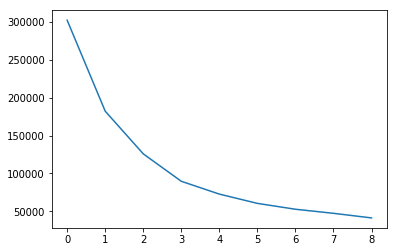

In [120]:
plt.plot(scores)

In [ ]:
#diagrama de silhouette. Ver el codigo del profesor.

In [ ]:
#Bueno, finalmente me ha gustado este modelo y el parametro eps=0,2.
#ahora tengo que INTERPRETAR LOS DATOS

In [121]:
rfm_o.head()

,customerID,recency,frequency,monetary
0,00001,272.0,1.0,11.77
1,00002,261.0,2.0,89.00
2,00003,181.0,3.0,61.06
3,00004,59.0,3.0,74.02
4,00005,15.0,8.0,261.21


In [159]:
labels2

array([0, 1, 2, ..., 2, 0, 1])

In [125]:
rfm_o['cluster']=labels2
#ahora tengo a cada cliente su cluster asignado

In [126]:
rfm_o.head()

,customerID,recency,frequency,monetary,cluster
0,00001,272.0,1.0,11.77,0
1,00002,261.0,2.0,89.00,1
2,00003,181.0,3.0,61.06,2
3,00004,59.0,3.0,74.02,2
4,00005,15.0,8.0,261.21,3


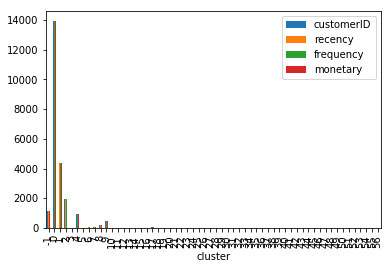

In [155]:
#vamos a agrupar por cluster y a pintarlo
rfm_o.groupby('cluster').count().plot(kind='bar')
#Sale raro, comparar con el del profesor.

In [128]:
#vemos los del cluster 2
rfm_o[rfm_o['cluster']==2].head()

,customerID,recency,frequency,monetary,cluster
2,00003,181.0,3.0,61.06,2
3,00004,59.0,3.0,74.02,2
10,00011,197.0,3.0,45.56,2
24,00025,44.0,3.0,51.11,2
27,00028,206.0,3.0,90.99,2


In [ ]:
#vemos que cluster es el 2 y el 3 y con qué se corresponde del histograma original.

In [130]:
rfm_2=rfm_o[rfm_o['cluster']==2].copy()

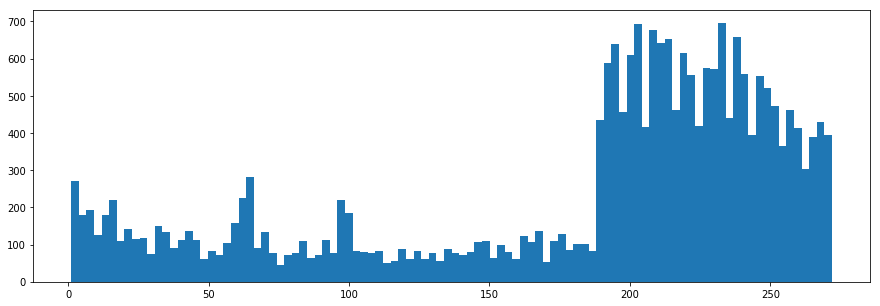

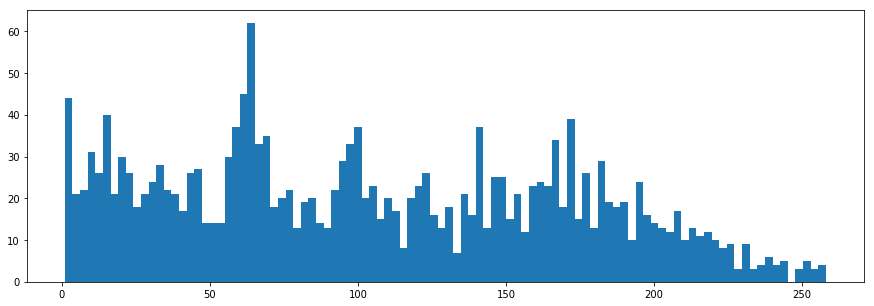

In [132]:
plt.figure(figsize=(15,5))
plt.hist(rfm_o['recency'],bins=100);
plt.show()
plt.figure(figsize=(15,5))
plt.hist(rfm_2['recency'],bins=100);

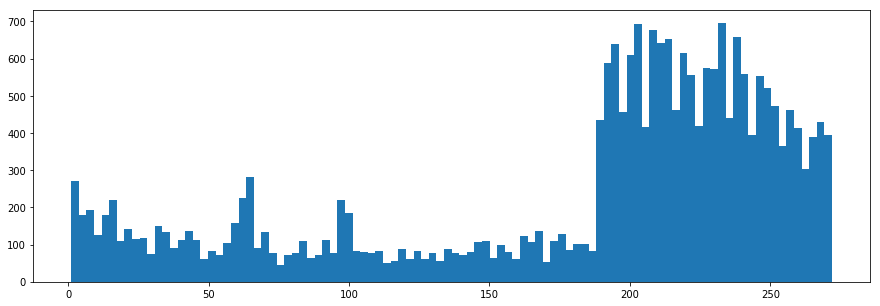

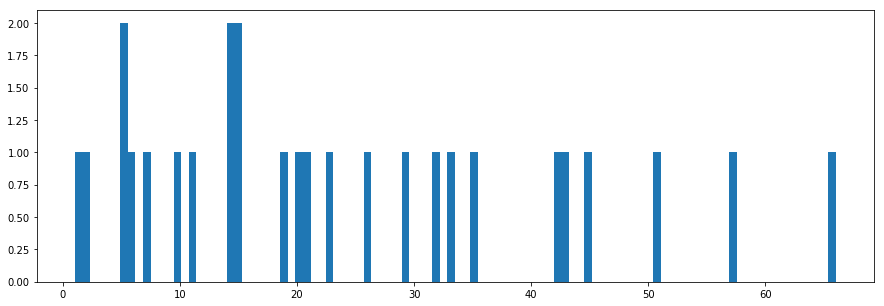

In [133]:
rfm_2=rfm_o[rfm_o['cluster']==3].copy()
plt.figure(figsize=(15,5))
plt.hist(rfm_o['recency'],bins=100);
plt.show()
plt.figure(figsize=(15,5))
plt.hist(rfm_2['recency'],bins=100);

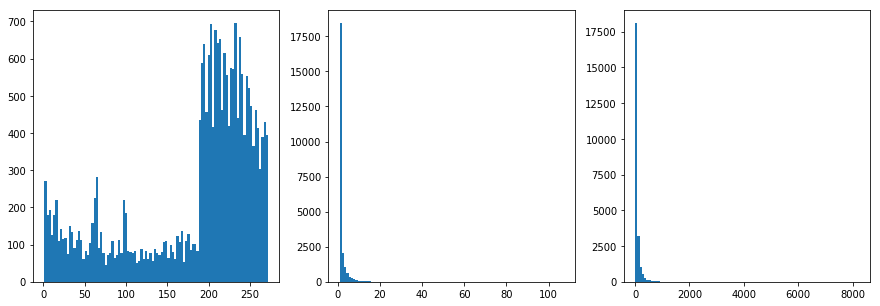

In [137]:
#Vamos a pintar una rejilla que nos permita comparar. CON EL RFM ORIGINAL
plt.figure(figsize=(15,5))
for i,col in enumerate(['recency','frequency','monetary']):
    plt.subplot(1,3,i+1)
    plt.hist(rfm_o[col],bins=100);
    


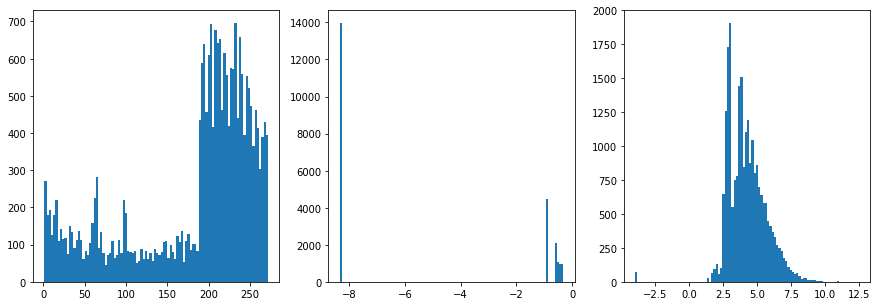

In [138]:
#Vamos a pintar una rejilla que nos permita comparar. CON EL RFM ORIGINAL
plt.figure(figsize=(15,5))
for i,col in enumerate(['recency','frequency','monetary']):
    plt.subplot(1,3,i+1)
    plt.hist(rfm[col],bins=100);

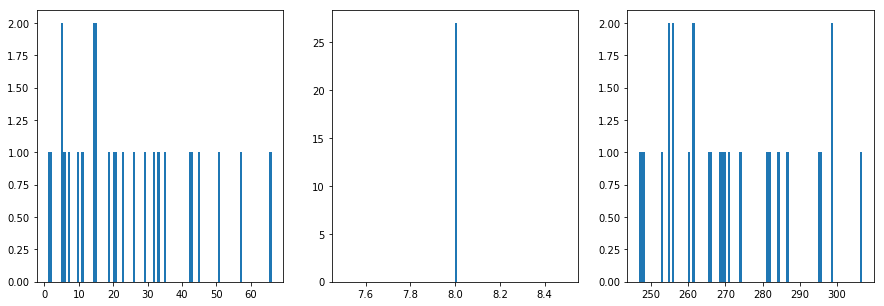

In [139]:
#Vamos a pintar una rejilla que nos permita comparar. CON EL RFM ORIGINAL
plt.figure(figsize=(15,5))
for i,col in enumerate(['recency','frequency','monetary']):
    plt.subplot(1,3,i+1)
    plt.hist(rfm_2[col],bins=100);

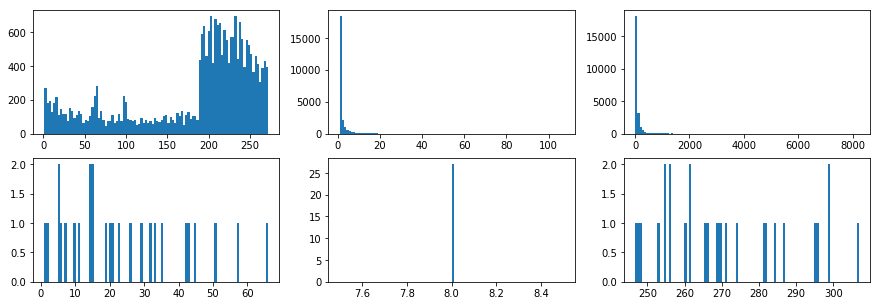

In [144]:
plt.figure(figsize=(15,5))
plt.subplot(2,3,1)
plt.hist(rfm_o['recency'],bins=100);
plt.subplot(2,3,2)
plt.hist(rfm_o['frequency'],bins=100);
plt.subplot(2,3,3)
plt.hist(rfm_o['monetary'],bins=100);
plt.subplot(2,3,4)
plt.hist(rfm_2['recency'],bins=100);
plt.subplot(2,3,5)
plt.hist(rfm_2['frequency'],bins=100);
plt.subplot(2,3,6)
plt.hist(rfm_2['monetary'],bins=100);

Original


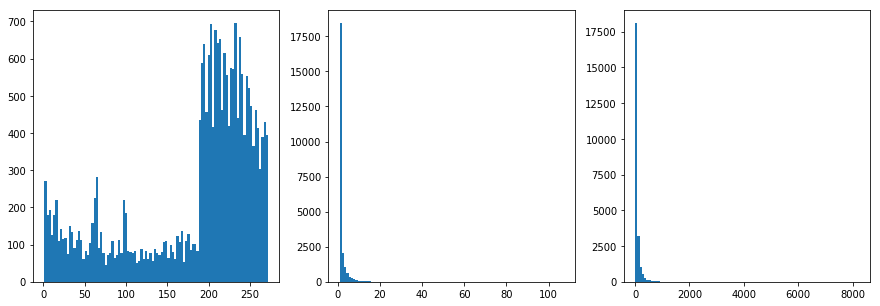

Cluster2


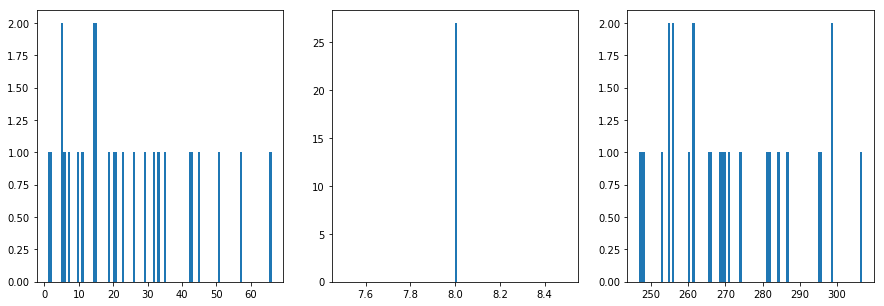

In [149]:
print('Original')
plt.figure(figsize=(15,5))
for i,col in enumerate(['recency','frequency','monetary']):
    plt.subplot(1,3,i+1)
    plt.hist(rfm_o[col],bins=100);
plt.show()
print('Cluster2')
plt.figure(figsize=(15,5))
for i,col in enumerate(['recency','frequency','monetary']):
    plt.subplot(1,3,i+1)
    plt.hist(rfm_2[col],bins=100);

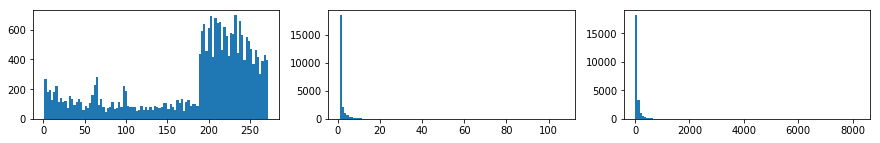

0


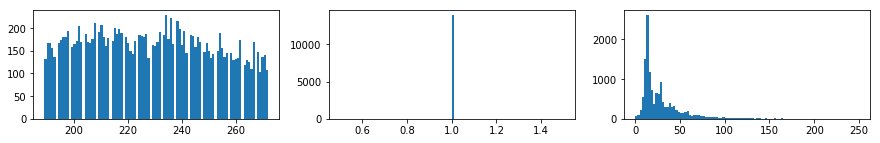

1


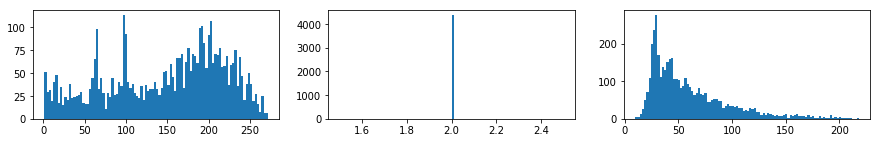

2


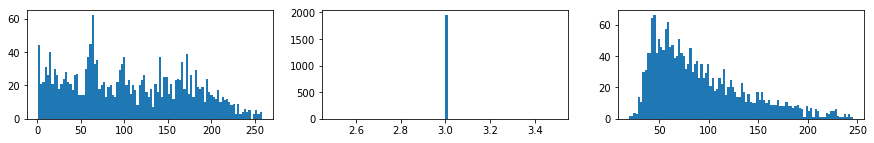

3


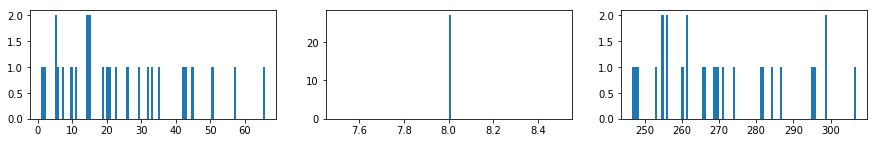

4


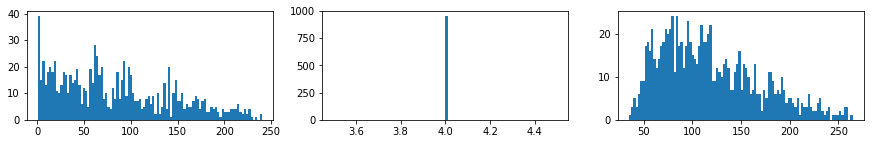

-1


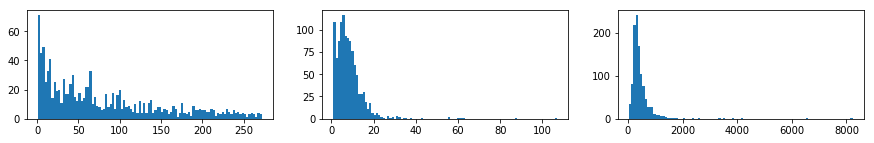

5


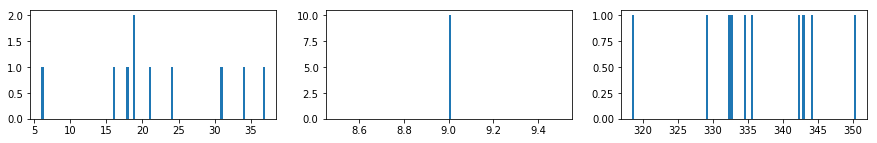

6


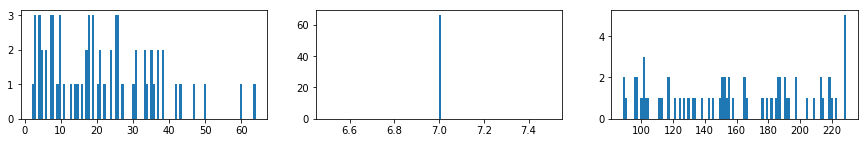

28


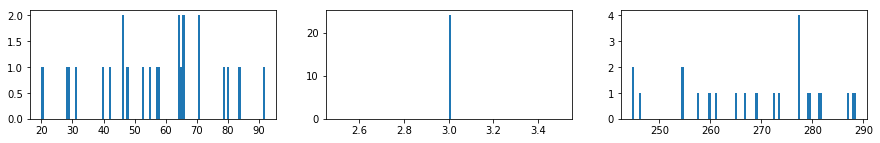

7


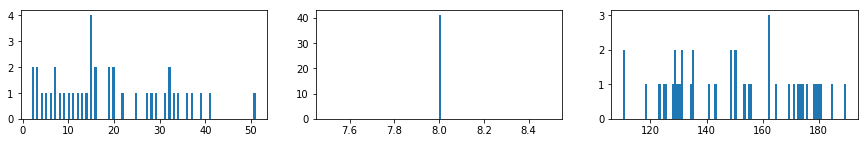

8


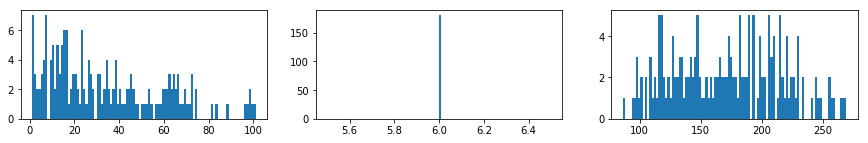

9


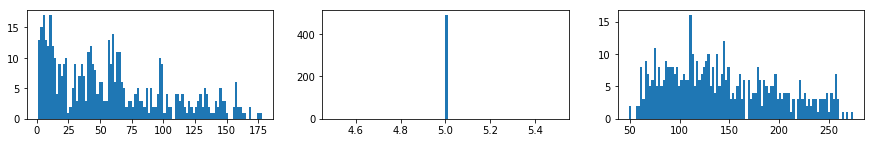

31


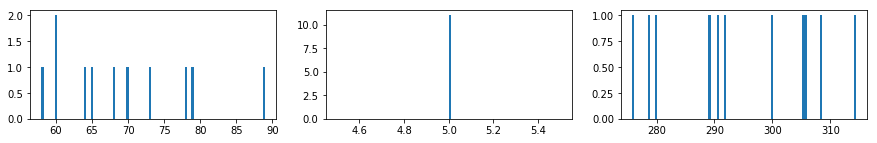

19


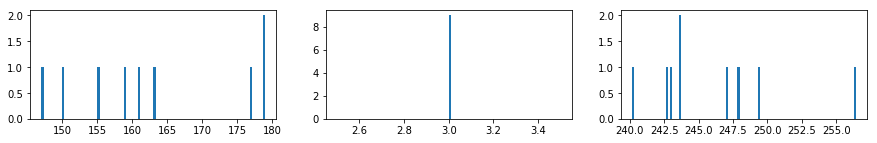

48


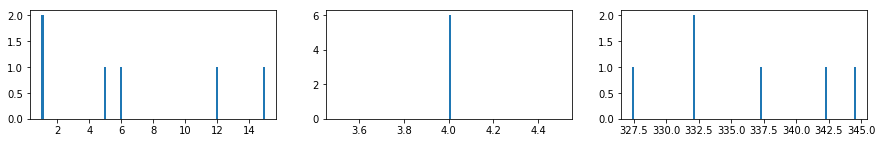

10


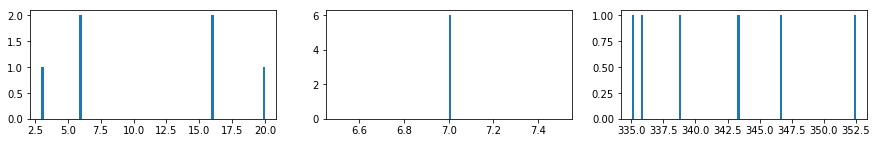

11


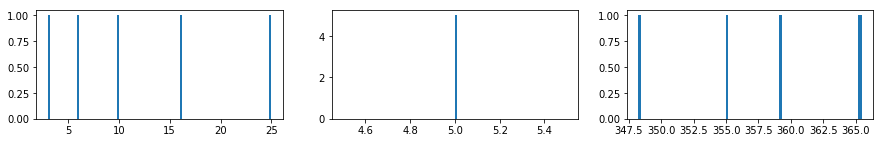

12


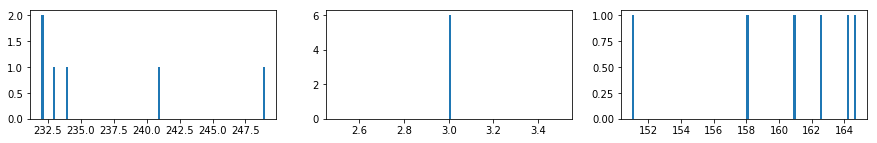

13


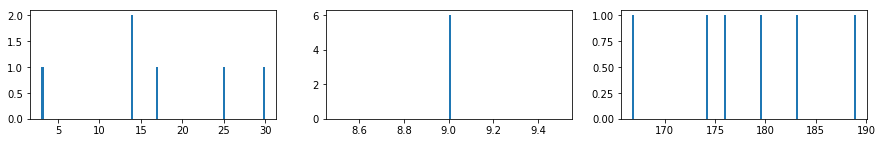

14


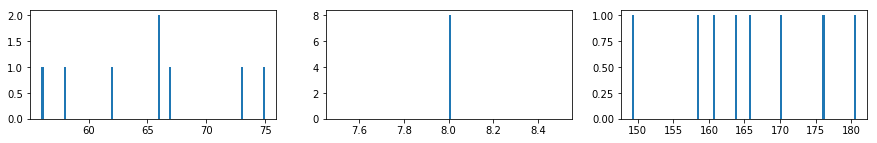

15


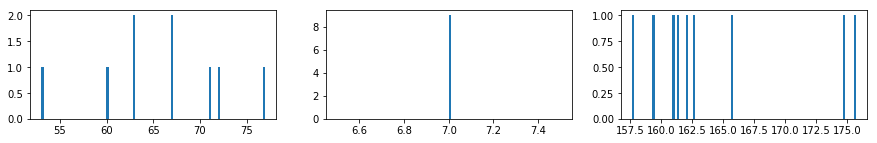

16


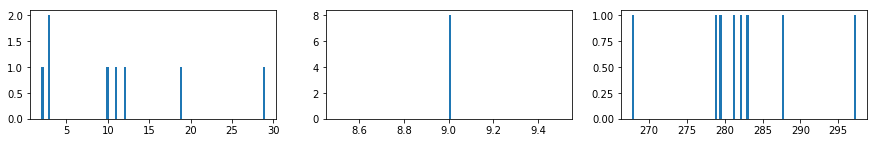

17


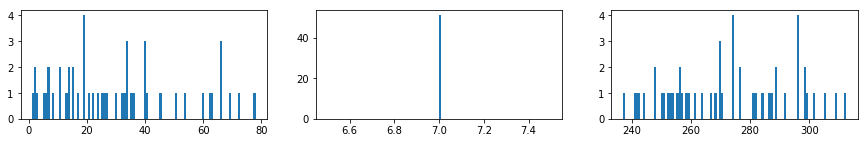

22


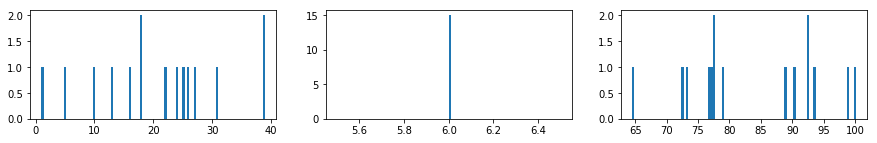

18


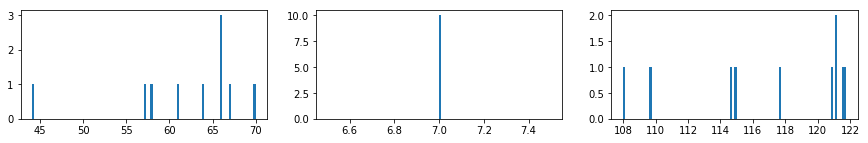

20


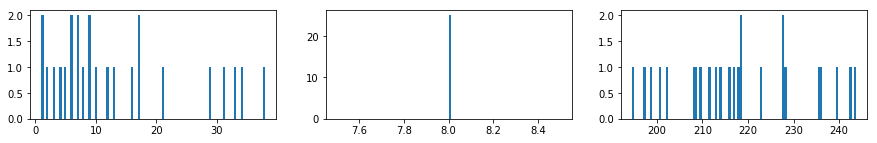

21


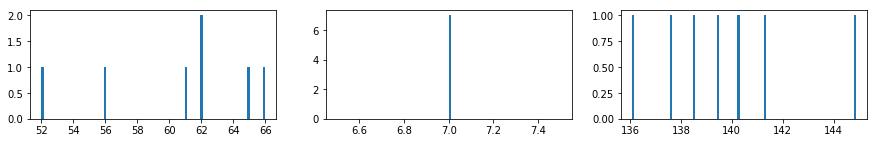

32


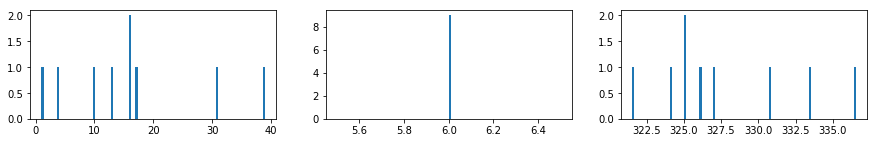

24


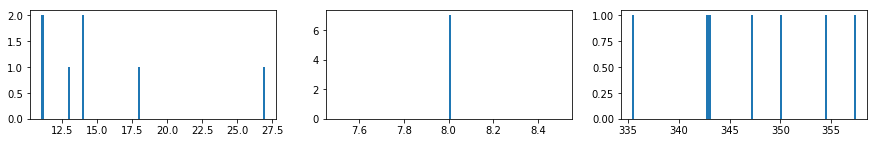

23


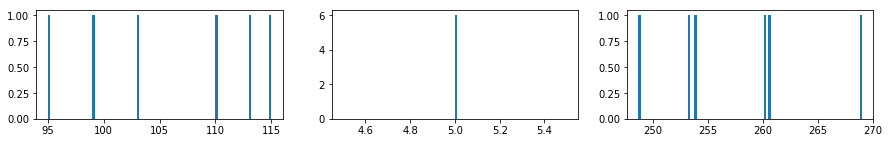

54


KeyboardInterrupt: 

In [150]:
#para que lo haga con todos los clusters:
plt.figure(figsize=(15,2))
for i,col in enumerate(["recency","frequency","monetary"]):
    plt.subplot(1,3,i+1)
    plt.hist(rfm_o[col],bins=100);
plt.show()
for i in rfm_o["cluster"].unique():
    plt.figure(figsize=(15,2))
    print(i)
    for j,col in enumerate(["recency","frequency","monetary"]):
        plt.subplot(1,3,j+1)
        plt.hist(rfm_o[rfm_o["cluster"]==i][col],bins=100);
    plt.show()

In [153]:
len(rfm_o["cluster"].unique())
#esto está mal, no puede haber 58 clusters. Revisar todo

58

In [ ]:
#VER MACHINE LEARNING CANVAS. Usarla como guia en un proyecto de ML